In [22]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium import Map, FeatureGroup, Marker, LayerControl
from shapely.geometry import Point
import requests
import json
import branca

%matplotlib inline

In [2]:
zip_codes = gpd.read_file('../data/geo_data/cb_2018_us_zcta510_500k.shp')

In [3]:
zip_codes

,ZCTA5CE10,AFFGEOID10,GEOID10,ALAND10,AWATER10,geometry
0,36083,8600000US36083,36083,659750662,5522919,"MULTIPOLYGON (((-85.63225 32.28098, -85.62439 ..."
1,35441,8600000US35441,35441,172850429,8749105,"MULTIPOLYGON (((-87.83287 32.84437, -87.83184 ..."
2,35051,8600000US35051,35051,280236456,5427285,"POLYGON ((-86.74384 33.25002, -86.73802 33.251..."
3,35121,8600000US35121,35121,372736030,5349303,"POLYGON ((-86.58527 33.94743, -86.58033 33.948..."
4,35058,8600000US35058,35058,178039922,3109259,"MULTIPOLYGON (((-86.87884 34.21196, -86.87649 ..."
...,...,...,...,...,...,...
33139,10983,8600000US10983,10983,5267037,16676,"POLYGON ((-73.96564 41.02787, -73.96612 41.029..."
33140,50460,8600000US50460,50460,93166133,0,"POLYGON ((-92.80629 43.23026, -92.80354 43.232..."
33141,40870,8600000US40870,40870,18226594,201441,"POLYGON ((-83.19264 36.91650, -83.19086 36.916..."
33142,40914,8600000US40914,40914,32269366,419039,"POLYGON ((-83.62748 37.07419, -83.62455 37.073..."


In [4]:
zip_codes = zip_codes.drop(['AFFGEOID10', 'GEOID10'], axis = 1)

In [5]:
zip_codes = zip_codes.rename({'ZCTA5CE10': 'zip',
                        'ALAND10': 'land_area',
                        'AWATER10': 'water_area'},
                        axis = 1)

In [6]:
zip_codes.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33144 entries, 0 to 33143
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   zip         33144 non-null  object  
 1   land_area   33144 non-null  int64   
 2   water_area  33144 non-null  int64   
 3   geometry    33144 non-null  geometry
dtypes: geometry(1), int64(2), object(1)
memory usage: 1.0+ MB


In [7]:
zip_codes['zip'] = zip_codes['zip'].astype('int64')

zip_codes.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33144 entries, 0 to 33143
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   zip         33144 non-null  int64   
 1   land_area   33144 non-null  int64   
 2   water_area  33144 non-null  int64   
 3   geometry    33144 non-null  geometry
dtypes: geometry(1), int64(3)
memory usage: 1.0 MB


In [8]:
zip_provider = pd.read_csv('../data/provider_zip_pop_cars.csv')

In [9]:
zip_provider

,rendering_zip,service_year,rendering_npi,state_x,total_pop,provider_per_1000,state_y,median_income,state,total_hh,total_no_veh,total_1_person_hh,1_person_hh_no_veh,total_no_car_ratio,1_per_no_car_ratio
0,37012,2019.0,2,47,2337.0,0.855798,47,39722.0,47,988.0,58.0,307.0,21.0,0.058704,0.068404
1,37012,2020.0,2,47,2337.0,0.855798,47,39722.0,47,988.0,58.0,307.0,21.0,0.058704,0.068404
2,37012,2021.0,2,47,2337.0,0.855798,47,39722.0,47,988.0,58.0,307.0,21.0,0.058704,0.068404
3,37013,2019.0,87,47,97819.0,0.889398,47,54811.0,47,35376.0,1140.0,9453.0,405.0,0.032225,0.042844
4,37013,2020.0,86,47,97819.0,0.879175,47,54811.0,47,35376.0,1140.0,9453.0,405.0,0.032225,0.042844
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1241,38583,2020.0,54,47,24089.0,2.241687,47,41363.0,47,8947.0,468.0,2208.0,372.0,0.052308,0.168478
1242,38583,2021.0,55,47,24089.0,2.283200,47,41363.0,47,8947.0,468.0,2208.0,372.0,0.052308,0.168478
1243,38585,2019.0,5,47,3970.0,1.259446,47,34245.0,47,1494.0,115.0,411.0,67.0,0.076975,0.163017
1244,38585,2020.0,5,47,3970.0,1.259446,47,34245.0,47,1494.0,115.0,411.0,67.0,0.076975,0.163017


In [10]:
zip_provider.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1246 entries, 0 to 1245
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   rendering_zip       1246 non-null   int64  
 1   service_year        1246 non-null   float64
 2   rendering_npi       1246 non-null   int64  
 3   state_x             1246 non-null   int64  
 4   total_pop           1246 non-null   float64
 5   provider_per_1000   1246 non-null   float64
 6   state_y             1246 non-null   int64  
 7   median_income       1246 non-null   float64
 8   state               1246 non-null   int64  
 9   total_hh            1246 non-null   float64
 10  total_no_veh        1246 non-null   float64
 11  total_1_person_hh   1246 non-null   float64
 12  1_person_hh_no_veh  1246 non-null   float64
 13  total_no_car_ratio  1231 non-null   float64
 14  1_per_no_car_ratio  1226 non-null   float64
dtypes: float64(10), int64(5)
memory usage: 146.1 KB


In [12]:
zip_provider[zip_provider['median_income'] == zip_provider['median_income'].min()]

,rendering_zip,service_year,rendering_npi,state_x,total_pop,provider_per_1000,state_y,median_income,state,total_hh,total_no_veh,total_1_person_hh,1_person_hh_no_veh,total_no_car_ratio,1_per_no_car_ratio
168,37132,2019.0,5,47,2387.0,2.094680,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN
169,37132,2020.0,5,47,2387.0,2.094680,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN
170,37132,2021.0,4,47,2387.0,1.675744,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN
280,37213,2019.0,3,47,100.0,30.000000,47,-666666666.0,47,11.0,0.0,11.0,0.0,0.000000,0.000000
281,37213,2020.0,3,47,100.0,30.000000,47,-666666666.0,47,11.0,0.0,11.0,0.0,0.000000,0.000000
282,37213,2021.0,2,47,100.0,20.000000,47,-666666666.0,47,11.0,0.0,11.0,0.0,0.000000,0.000000
310,37240,2019.0,4,47,778.0,5.141388,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN
311,37240,2020.0,4,47,778.0,5.141388,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN
312,37240,2021.0,2,47,778.0,2.570694,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN
341,37315,2019.0,3,47,1566.0,1.915709,47,-666666666.0,47,0.0,0.0,0.0,0.0,NaN,NaN


In [13]:
zip_provider.loc[zip_provider['median_income'] < 0] = 0

In [14]:
zip_provider = zip_provider.drop('state_y', axis = 1).rename({'state_x': 'state'})

In [15]:
zip_codes = pd.merge(left = zip_codes,
         right = zip_provider,
         left_on = 'zip',
         right_on = 'rendering_zip')

zip_codes

,zip,land_area,water_area,geometry,rendering_zip,service_year,rendering_npi,state_x,total_pop,provider_per_1000,median_income,state,total_hh,total_no_veh,total_1_person_hh,1_person_hh_no_veh,total_no_car_ratio,1_per_no_car_ratio
0,37066,296571031,15770388,"POLYGON ((-86.58467 36.41678, -86.57109 36.412...",37066,2019.0,217,47,50328.0,4.311715,60065.0,47,18699.0,819.0,4458.0,504.0,0.043799,0.113055
1,37066,296571031,15770388,"POLYGON ((-86.58467 36.41678, -86.57109 36.412...",37066,2020.0,227,47,50328.0,4.510412,60065.0,47,18699.0,819.0,4458.0,504.0,0.043799,0.113055
2,37066,296571031,15770388,"POLYGON ((-86.58467 36.41678, -86.57109 36.412...",37066,2021.0,246,47,50328.0,4.887935,60065.0,47,18699.0,819.0,4458.0,504.0,0.043799,0.113055
3,38301,427555600,617738,"POLYGON ((-89.07140 35.63486, -89.07094 35.640...",38301,2019.0,437,47,33168.0,13.175350,30952.0,47,13147.0,1842.0,4944.0,1121.0,0.140108,0.226739
4,38301,427555600,617738,"POLYGON ((-89.07140 35.63486, -89.07094 35.640...",38301,2020.0,466,47,33168.0,14.049686,30952.0,47,13147.0,1842.0,4944.0,1121.0,0.140108,0.226739
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1218,37323,309435474,285564,"POLYGON ((-84.94033 34.99622, -84.93666 35.004...",37323,2020.0,18,47,31178.0,0.577330,49288.0,47,12129.0,370.0,3097.0,214.0,0.030505,0.069099
1219,37323,309435474,285564,"POLYGON ((-84.94033 34.99622, -84.93666 35.004...",37323,2021.0,18,47,31178.0,0.577330,49288.0,47,12129.0,370.0,3097.0,214.0,0.030505,0.069099
1220,37097,278382373,4320046,"POLYGON ((-87.97985 35.77891, -87.97655 35.787...",37097,2019.0,2,47,2254.0,0.887311,31645.0,47,950.0,68.0,239.0,21.0,0.071579,0.087866
1221,37097,278382373,4320046,"POLYGON ((-87.97985 35.77891, -87.97655 35.787...",37097,2020.0,2,47,2254.0,0.887311,31645.0,47,950.0,68.0,239.0,21.0,0.071579,0.087866


In [55]:
zip_codes[zip_codes['1_per_no_car_ratio'].isna()]

,zip,land_area,water_area,geometry,rendering_zip,service_year,rendering_npi,state_x,total_pop,provider_per_1000,median_income,state,total_hh,total_no_veh,total_1_person_hh,1_person_hh_no_veh,total_no_car_ratio,1_per_no_car_ratio
1109,37118,88166257,0,"POLYGON ((-86.24331 35.99629, -86.24294 35.997...",37118,2019.0,1,47,1033.0,0.968054,77611.0,47,338.0,0.0,0.0,0.0,0.0,NaN
1110,37118,88166257,0,"POLYGON ((-86.24331 35.99629, -86.24294 35.997...",37118,2020.0,1,47,1033.0,0.968054,77611.0,47,338.0,0.0,0.0,0.0,0.0,NaN


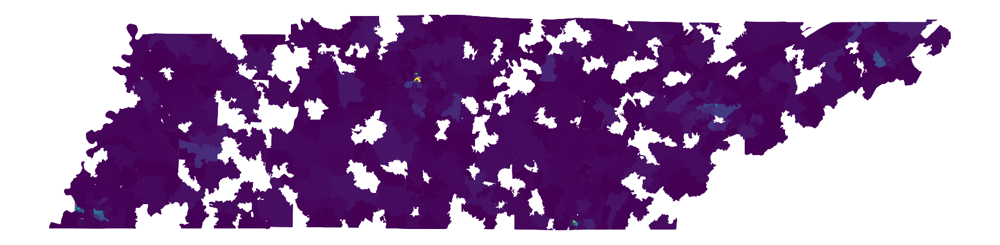

In [16]:
fig, ax = plt.subplots(figsize=(30,15))
zip_codes.plot(column = 'provider_per_1000', 
              ax = ax)
ax.axis('off');

In [17]:
area_center = ['35.8597', '-86.3620']

map_total = folium.Map(location =  area_center, zoom_start = 8.4)

total = folium.Choropleth(
     geo_data = zip_codes,
     name = 'Provider Per 1000 Residents',
     data = zip_codes,
     columns = ['zip','provider_per_1000'],
     key_on = 'feature.properties.zip',
     fill_color = 'YlGnBu',
     fill_opacity = 0.5,
     line_opacity = 1,
     legend_name = 'Providers Per 1000 Residents',
     smooth_factor = 0,
     overlay = True
    ).add_to(map_total)

map_total

In [56]:
rate = folium.Choropleth(
     geo_data = zip_codes[zip_codes['service_year'] == 2021],
     name = 'Provider Per 1000 Residents',
     data = zip_codes[zip_codes['service_year'] == 2021],
     columns = ['zip','provider_per_1000'],
     key_on = 'feature.properties.zip',
     fill_color = 'Reds_r',
     fill_opacity = 0.3,
     line_opacity = 1,
     legend_name = 'Providers Per 1000 Residents',
     smooth_factor = 0,
     overlay = True
    )

median_income = folium.Choropleth(
    geo_data = zip_codes[zip_codes['service_year'] == 2021],
    name = 'Median Income',
    data = zip_codes[zip_codes['service_year'] == 2021],
    columns = ['zip', 'median_income'],
    key_on = 'feature.properties.zip',
    fill_color = 'Reds_r',
    fill_opacity = 0.3,
    line_opacity = 1.0,
    legend_name = 'Median Income',
    smooth_factor = 0,
    overlay = True
   )

hh_cars = folium.Choropleth(
    geo_data = zip_codes[zip_codes['service_year'] == 2021],
    name = 'HH With No Cars',
    data = zip_codes[zip_codes['service_year'] == 2021],
    columns = ['zip', 'total_no_car_ratio'],
    key_on = 'feature.properties.zip',
    fill_color = 'Reds',
    fill_opacity = 0.3,
    line_opacity = 1.0,
    legend_name = 'Ratio Of Total HH With No Car',
    smooth_factor = 0,
    overlay = True
   )

single_cars = folium.Choropleth(
    geo_data = zip_codes[zip_codes['service_year'] == 2021],
    name = 'One Person HH With No Cars',
    data = zip_codes[zip_codes['service_year'] == 2021],
    columns = ['zip', '1_per_no_car_ratio'],
    key_on = 'feature.properties.zip',
    fill_color = 'Reds',
    fill_opacity = 0.3,
    line_opacity = 1.0,
    legend_name = 'Ratio Of One Person HH With No Car',
    smooth_factor = 0,
    overlay = True
   )

In [57]:
map_both = folium.Map(location =  area_center, zoom_start = 8.3)

map_both.add_child(rate).add_child(median_income).add_child(hh_cars).add_child(single_cars)
map_both.add_child(folium.map.LayerControl())

style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
NIL = folium.features.GeoJson(
    data = zip_codes,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['zip', 'rendering_npi', 'provider_per_1000','total_pop', 'median_income', 'total_no_car_ratio', '1_per_no_car_ratio'],
        aliases=['zip code', 'count of providers', 'providers per 1000','population', 'median income', 'HH with no car', 'single person HH no car'],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
map_both.add_child(NIL)
map_both.keep_in_front(NIL)

map_both.save('../data/maps/tn_choropleth.html')

map_both

In [58]:
zip_codes.to_csv('../data/zip_codes_pop_cars.csv', index = False)